# World Data League 2022

## 🎯 Challenge 3
*Predicting a safety score for Women in Costa Rica*

Consider looking through our notebook on [Google Colab](https://colab.research.google.com/drive/1hCnVtEbstn6cYGNkwbnaMvUUuhF6JcGn) for the best experience

## 👥 Authors
* Ivan Vrkic
* Manuel Bürgler
* Lukas Mölschl

## 💻 Development



### 🧰 Dependencies, Libraries & Tools

To keep things simple, we decided to go with a pretty standard aproach utilizing the power of `pandas`, the vizualisation magic from `plotly`, forecasting by `prophet` and geospatial tools from `geopandas` as well as `folium`. 
A bit more of an exotic is `h3` from Uber which helps us greatly in the geospatial analysis. 

In [ ]:
#@title pip installs
!pip install pystan==2.19.1.1 >/dev/null &2>/dev/null
!pip install pandas numpy matplotlib seaborn scikit-learn sklearn prophet plotly requests nbformat chart_studio folium distinctipy statsmodels==0.13.2 shapely
#order matters
!pip install geopandas 
!pip install pydeck
!pip install transformers
#updating  pyyaml to version 6.0 is not compatible with the current way Google Colab imports packages. So just reverting back to pyyaml version 5.4.1 solves the problem.
!pip install pyyaml==5.4.1

In [ ]:
#@title Libs & Imports

# Standard lib
import pydeck as pdk
import os
import requests
import itertools
import json
import urllib
import zipfile
from typing import Tuple
import base64
import tempfile
import datetime as dt
import pprint 
pp = pprint.PrettyPrinter(indent=4) 


# DataFrame and math ops
import pandas as pd
import numpy as np 
from tqdm.notebook import tqdm
tqdm.pandas()

# Plotting libraries
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import cm

from chart_studio import plotly

import plotly.express as px
import plotly.offline as py
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode, iplot
from plotly.subplots import make_subplots
init_notebook_mode(connected=True)

# https://stackoverflow.com/a/57903750/ 
import plotly.io as pio
# pio.renderers.default = "colab"
import distinctipy
# Re-run the whole notebook with this flag enabled so it renders as HTML
pio.renderers.default = "notebook"

# Geo libraries
import geopandas as gpd
import geopandas
from geopandas import GeoDataFrame
import shapely
import xarray as xr
from shapely.geometry import mapping
from shapely.ops import cascaded_union, unary_union
from shapely.geometry.point import Point
from geopy import distance
import folium 
from folium.features import DivIcon
from transformers import pipeline
from shapely.geometry.polygon import Polygon


sns.set(rc={'figure.figsize': (17, 9)})


# ML modeling
from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import FactorAnalysis

# EDA
from statsmodels.tsa.seasonal import seasonal_decompose, STL

DEBUG = False

import pickle

import warnings
warnings.filterwarnings('ignore')

### 💡 A (very) short intro into the topic


### ⏬ ETL
The ETL pipline prepares the dataset for the following analysis. The folowing steps are executed:

1. Load the data, cast datatypes and drop empty columns
1. Create different dataframes for customer trips and scooter operator events

A detailed description and justification why we selected this time period or how our population model works can be found in the **APPENDIX**. 

#### ETL Processing

In [ ]:
#@title ETL Procesing
DATA_DIR = 'data'
DATAFILE = os.path.join(DATA_DIR, 'urbanalytica_datasets.zip')

def create_data_dir():
    if not os.path.exists(DATA_DIR):
        os.makedirs(DATA_DIR)

def load_crime_dataset(transform=True):
    create_data_dir()
    # Download dataset
    URL = 'https://wdl-data.fra1.digitaloceanspaces.com/urbanalytica/urbanalytica_datasets.zip'

    if not os.path.exists(DATAFILE):
      res = requests.get(URL, allow_redirects=True)
      with open(DATAFILE, 'wb') as data_file:
          data_file.write(res.content)
    
    with zipfile.ZipFile(DATAFILE, 'r') as zip_ref:
        zip_ref.extractall(DATA_DIR)

    df_crimes = pd.read_csv(os.path.join(
    'data/datasets/costa_rica_crime_data_english/', 'costa_rica_crimes_english.csv'))

    df_crimes = df_crimes.astype({
        'Crime': 'category',
        'SubtypeCrime': 'category',
        'Date': 'datetime64[ns]',
        'Time': 'category',
        'SubtypeVictim': 'category',
        'Age': 'category',
        'Gender': 'category',
        'Nationality': 'category',
        'Province': 'category',
        'Canton': 'category',
        'District': 'category',
    })
    
    df_crimes.set_index('Date', inplace=True)
    df_crimes['District'] = pd.Series(df_crimes['District'], dtype="string")
    df_crimes['District'] = df_crimes['District'].str.strip()
    df_crimes['District'] = df_crimes['District'].str.lower()

    return df_crimes

def load_dataset_complete(transform=True):
    create_data_dir()
    # Download dataset
    df_crimes = load_crime_dataset()

    """
    Load District Data
    """

    df_districts = pd.read_csv(os.path.join(
        'data/datasets/', 'district_data.csv'))

    # Explode collection of {Province, Canton, District} into columns
    df_districts['tmp'] = df_districts['{Provincia, Canton, Distrito}'].str.translate({ord('{'): '', ord('}'): '', ord('"'): ''}).str.split(',')
    tmp = df_districts['tmp'].apply(pd.Series).rename({0: 'Province', 1: 'Canton', 2: 'District'}, axis=1)
    df_districts = df_districts.join(tmp).drop(columns=['tmp', '{Provincia, Canton, Distrito}']).astype({
        'District': str,
    })

    for column in ['Province', 'Canton', 'District']:
      df_districts[column] = pd.Series(df_districts[column], dtype="string")
      df_districts[column] = df_districts[column].str.strip().str.lower()

    # ToDo: Filter by date?
    female_filter = df_crimes['Gender'] == 'female'
    # year_filter = (df_crimes.index < '2020-01-01') & (df_crimes.index >= '2019-01-01')
    df_crimes_female_grouped = df_crimes[female_filter].groupby('District').count().reset_index()[['District', 'Crime']]
    df_joined = pd.merge(df_districts, df_crimes_female_grouped, how='left',  left_on="District", right_on="District", suffixes=('_x', '_y'))
    
    """
    Load District ID from ArcGIS data
    """
    # Load arcgis district description and merge it with main dataframe
    # `Id_Distrito` holds the information about the district id 
    df_arcgis_districts = pd.read_csv(os.path.join(
        'data/datasets/arcGIS_zoning_data_san_jose/', 'arcGIS_districts.csv'))
    df_arcgis_districts['Nombre'] = df_arcgis_districts['Nombre'].str.lower()
    df_arcgis_districts.drop(columns=['Unnamed: 0', 'OBJECTID',  'Shape.STArea()', 'Shape.STLength()', 'SHAPE'], inplace=True)
    df_joined = pd.merge(df_joined, df_arcgis_districts, how='left', left_on='District', right_on='Nombre')
    
    """
    Load churches data and aggregate count by district
    """

    df_curches = pd.read_csv(os.path.join(
    'data/datasets/arcGIS_zoning_data_san_jose/', 'arcGIS_churches.csv'))
    df_curches = df_curches.groupby('ID_DISTRITO').count().reset_index()
    df_curches.drop(columns=['OBJECTID', 'CATEGORIA', 'NOMBRE',
          'ABREVIADO', 'PROPIETARIO', 'SHAPE'], inplace=True)
    df_curches.rename(columns={
        'Unnamed: 0': 'churches'
    }, inplace=True)

    df_joined = pd.merge(df_joined, df_curches, how='left', left_on='Id_Distrito', right_on='ID_DISTRITO')
    

    """
    Load entertainment data and aggregate count by district
    """

    df_entertainment = pd.read_csv(os.path.join(
    'data/datasets/arcGIS_zoning_data_san_jose/', 'arcGIS_entertainment_culture.csv'))
    df_entertainment = df_entertainment.groupby('ID_DISTRITO').count().reset_index()
    df_entertainment.drop(columns=['OBJECTID', 'NOMBRE', 'ENTIDAD', 'ABREVIADO', 'CATEGORIA', 'ID', 'SHAPE'], inplace=True)
    df_entertainment.rename(columns={
        'Unnamed: 0': 'entertainment'
    }, inplace=True)

    df_joined = pd.merge(df_joined, df_entertainment, how='left', left_on='Id_Distrito', right_on='ID_DISTRITO')
    df_joined = df_joined[(df_joined['Canton'] == 'san jose') & (df_joined['Province'] == 'san jose')]
    df_joined = df_joined.fillna(0)
    

    return df_joined

def load_district_data(transform=True):
  create_data_dir()
  # Download dataset
  URL = 'https://wdl-data.fra1.digitaloceanspaces.com/urbanalytica/urbanalytica_datasets.zip'

  if not os.path.exists(DATAFILE):
    res = requests.get(URL, allow_redirects=True)
    with open(DATAFILE, 'wb') as data_file:
        data_file.write(res.content)

  with zipfile.ZipFile(DATAFILE, 'r') as zip_ref:
      zip_ref.extractall(DATA_DIR)

  df_districts = pd.read_csv(os.path.join(
  'data/datasets/', 'district_data.csv'))

  # Explode collection of {Province, Canton, District} into columns
  df_districts['tmp'] = df_districts['{Provincia, Canton, Distrito}'].str.translate({ord('{'): '', ord('}'): '', ord('"'): ''}).str.split(',')
  tmp = df_districts['tmp'].apply(pd.Series).rename({0: 'Province', 1: 'Canton', 2: 'District'}, axis=1)
  df_districts = df_districts.join(tmp).drop(columns=['tmp', '{Provincia, Canton, Distrito}']).astype({
    'District': str,
  })

  for column in ['Province', 'Canton', 'District']:
    df_districts[column] = pd.Series(df_districts[column], dtype="string")
    df_districts[column] = df_districts[column].str.strip().str.lower()

  return df_districts

def check_safe_5367(x: pd.Series):
  """Checks if it is safe to convert to EPSG5367"""
  for v in x.values:
      t = json.loads(v.replace("'", '"'))
      if len(t['rings']) > 1:
        raise ValueError('Not safe to convert')
  print('Safe to convert')

def convert_poly(x: str) -> Polygon:
  """Converts JSON String (ref. http://esri.github.io/geometry-api-java/doc/Polygon.html) to Polygon"""
  geom = json.loads(x.replace("'", '"'))
  return Polygon(geom['rings'][0])

def convert_5367(x: pd.DataFrame) -> gpd.GeoDataFrame:
  """Converts arcGIS DataFrames to GeoDataFrames with EPSG 5367 crs"""
  check_safe_5367(x['SHAPE'])
  x['geometry'] = x['SHAPE'].apply(convert_poly)
  return gpd.GeoDataFrame(x, crs="epsg:5367")


def load_arcgis_districts():
  """Load ArcGIS Districts GeoDataFrame"""

  df_arcGIS_districts = pd.read_csv(os.path.join(
    'data/datasets/arcGIS_zoning_data_san_jose/', 'arcGIS_districts.csv'))
  df_arcGIS_districts = convert_5367(df_arcGIS_districts).to_crs(4326)
  df_c = pd.read_csv(os.path.join(
    'data/datasets/costa_rica_crime_data_english/', 'costa_rica_crimes_english.csv'))
  df_c['Date'] = pd.to_datetime(df_c['Date'], infer_datetime_format=True)
  df_c.sort_values(['Date','Time'])
  df_c['District']=df_c['District'].replace({'SAN FRANCISCO DE DOS RIOS':'SAN FRANCISCO DE DOS RÍOS','SAN SEBASTIAN':'SAN SEBASTIÁN'})
  df_c['District'] = df_c['District'].str.upper()

  df_arcGIS_districts.rename(columns={"Nombre": "District"},inplace=True)
  district_set = set(df_arcGIS_districts['District'].tolist())
  district_set

  df_c_grouped_districts = df_c.groupby(['District']).count().iloc[:,1:2].reset_index()
  df_c_grouped_districts.rename(columns={"Crime": "Crimes",},inplace=True)
  df_c_grouped_districts_sj  = df_c_grouped_districts[df_c_grouped_districts.District.isin(district_set)]
  df_c_grouped_districts_sj = df_c_grouped_districts_sj.merge(df_arcGIS_districts)
  df_arcGIS_districts = gpd.GeoDataFrame(df_c_grouped_districts_sj, crs="epsg:4326")
  df_arcGIS_districts['Id_Distrito'] = df_arcGIS_districts['Id_Distrito'].astype(str)
  return df_arcGIS_districts

def load_all_gdf_districts():
  """Load GeoDataFrame with all districts"""
  gdf_district_shapes=gpd.read_file('cri_adm_2021_wgs_84/cri_admbnda_adm3_2021_WGS_84.shp')
  gdf_district_shapes['ADM1_ES']=gdf_district_shapes['ADM1_ES'].apply(lambda x: x.upper())
  gdf_district_shapes['ADM2_ES']=gdf_district_shapes['ADM2_ES'].apply(lambda x: x.upper())
  gdf_district_shapes['ADM3_ES']=gdf_district_shapes['ADM3_ES'].apply(lambda x: x.upper())
  gdf_district_shapes = gdf_district_shapes.drop(['ADM0_ES','ADM0_PCODE'],axis=1)
  gdf_district_shapes.rename(columns={"ADM1_ES": "Province","ADM2_ES": "Canton","ADM3_ES": "District"},inplace=True)
  
  df_c = pd.read_csv(os.path.join(
    'data/datasets/costa_rica_crime_data_english/', 'costa_rica_crimes_english.csv'))
  df_c_grouped_all = df_c.groupby(['Province','Canton','District']).count().iloc[:,1:2].reset_index()
  gdf_district_all = gdf_district_shapes.merge(df_c_grouped_all,how='left',on=['Province','Canton','District'])
  gdf_district_all.rename(columns={"Crime": "Crimes"},inplace=True)
  return gdf_district_all

In [ ]:
# Load Data
df_crimes = load_crime_dataset()
df_districts = load_district_data()

In [ ]:
df_sanjose = load_dataset_complete()

### 🌎 Part 1: WHERE & WHEN

In this section we will investigate under the scope of __violence and harassment against women__ of the two main datasets that Urbanalytica is providing. 
- _Crimes in Costa Rica_ is a database with crimes that were recorded from 2010 to 2022.


The dataset contains over 645.000 entries of recorded crime all over Costa Rica. Over 215.000 crimes recorded in this dataset were against women.
The main objective of this report is to include 
There is data available for all 7 provinces [1], all 83 cantons [2] but only for 391 out of total 488 [3] districts within the cantons. 

[1] https://en.wikipedia.org/wiki/Provinces_of_Costa_Rica \
[2] https://en.wikipedia.org/wiki/Cantons_of_Costa_Rica   \
[3] https://en.wikipedia.org/wiki/Districts_of_Costa_Rica 

#### Time series analysis

0.8837125004720789


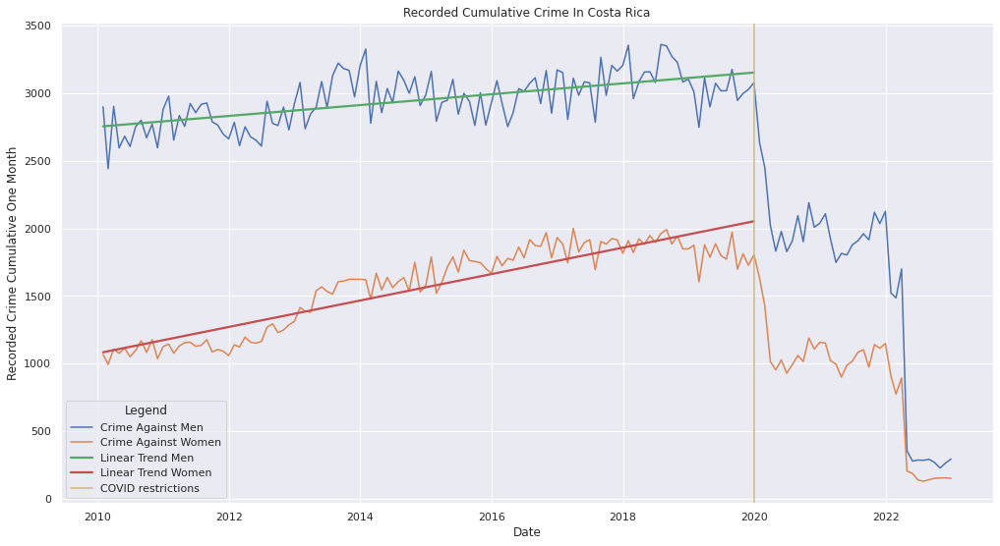

In [ ]:
#@title Time series analysis
female_filter = df_crimes['Gender'] == 'female'
df_crime_f_month = df_crimes[df_crimes['Gender'] == 'female']
df_crime_m_month = df_crimes[df_crimes['Gender'] == 'male']

fig , ax = plt.subplots()

x = df_crime_f_month.resample('1M').count().reset_index()['Date']
y_men = df_crime_m_month.resample('1M').count().reset_index()['Crime']
y_women = df_crime_f_month.resample('1M').count().reset_index()['Crime']

date_filter = x < '2020-01-01'

_ = sns.lineplot(x=x, y=y_men)
_ = sns.lineplot(x=x, y=y_women)

ax.xaxis.update_units(x)
_ = sns.regplot(x=ax.xaxis.convert_units(x[date_filter]), y=y_men[date_filter], scatter=False, ci=None)
_ = sns.regplot(x=ax.xaxis.convert_units(
    x[date_filter]), y=y_women[date_filter], scatter=False, ci=None)


plt.axvline(dt.date(year=2020, month=1, day=1), color='y')
plt.legend(title='Legend', loc='lower left', labels=[
           "Crime Against Men", "Crime Against Women", "Linear Trend Men", "Linear Trend Women", "COVID restrictions"])
ax.set(ylabel='Recorded Crime Cumulative One Month',
       title='Recorded Cumulative Crime In Costa Rica')

print(y_women.corr(y_men))

The first interesting thing that when plotting the history of recorded crime against women and men is the massive decrease of crime reports after COVID started. A drop in crime is expected with restrictions in place, but restrictions were not in place after March of 2020. Still we can see the drop starting at exactly with the 01.01.2020. This means that the statistics for crime are recorded at least 3 months after they happend, this also explains why we only have data for early 2022. 

Secondly, the time series of crime against women and men correlate which can also be seen visually. We computed a pearson correlation `[1]` of *0.88* 
betwen the two time series, which suggests that they actually do correlate. This suggests that the crime that is happening against women is not (completly) decoupled from the crime that is happening against men. 

Finally and the most important observation is, that the growth rate of crime against women is way bigger than the growth rate of crime against men. The recorded crime against women almost doubled in the years from 2010 to 2020!

There are no official statements, but we expect that due to COVID the actual number of crimes is at least back to pre-COVID numbers and we see an under reporting of crimes due to the circumstances. 


`[1]` A Pearson correlation can take values between -1 and +1. Where -1 is a strong negative correlation, 0 is no correlation at all and +1 is a strong positive correlation. 

#### Geospatial analysis

To investigate the crimes on women, all districts in Costa Rica were queried using OSM together with their respective shapefiles and combined with the crime dataset. The results are shown on the map below.

In [ ]:
!gdown 1hZKuqbdXa42WuniiEWaxB51WvSDSiAUq
!unzip -o cri_adm_2021_wgs_84-20220523T185224Z-001.zip

In [ ]:
#@title Canton analysis
df_arcgis_districts = load_arcgis_districts()
cr_map = folium.Map(location=[9.93,-84.07], zoom_start=13,
                    tiles='https://api.mapbox.com/styles/v1/mapbox/dark-v10/tiles/{z}/{x}/{y}?access_token=pk.eyJ1IjoibHVtb2UiLCJhIjoiY2wyNXk1a3FnMG4wNDNjcWl5OGhkOXR5dCJ9.Q56CyIVs0C-kaED1Q4HJtQ',
                    attr='Mapbox')

geo = gpd.GeoSeries(df_arcgis_districts.set_index('Id_Distrito')['geometry']).to_json()

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.3, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
NIL = folium.GeoJson(
    df_arcgis_districts[['District','Crimes','geometry']],
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(fields=['District','Crimes'],
            aliases=['District:','Crimes:'],
            style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;"),
            sticky=True
        )
)
cr_map.add_child(NIL)
cr_map.keep_in_front(NIL)
myscale = (df_arcgis_districts['Crimes'].quantile((0,0.1,0.75,0.9,0.98,1))).tolist()
folium.Choropleth(
  geo_data = geo,
  name = 'Crimes',
  data = df_arcgis_districts,
  columns = ['Id_Distrito','Crimes'],
  key_on = 'feature.id',
  fill_color = 'YlOrRd',
  #threshold_scale=myscale,
  fill_opacity=0.8,
  line_opacity=0.2,
  legend_name = 'Crimes',
  smooth_factor=  0
).add_to(cr_map)

folium.LayerControl().add_to(cr_map)
cr_map

Safe to convert


In [ ]:
#@title Costa Rica analysis

gdf_district_all = load_all_gdf_districts()
cr_map = folium.Map(location=[9.93,-84.07], zoom_start=13,
                    tiles='https://api.mapbox.com/styles/v1/mapbox/dark-v10/tiles/{z}/{x}/{y}?access_token=pk.eyJ1IjoibHVtb2UiLCJhIjoiY2wyNXk1a3FnMG4wNDNjcWl5OGhkOXR5dCJ9.Q56CyIVs0C-kaED1Q4HJtQ',
                    attr='Mapbox')

geo = gpd.GeoSeries(gdf_district_all.set_index('ADM3_PCODE')['geometry']).to_json()

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.3, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
NIL = folium.GeoJson(
    gdf_district_all[['District','Crimes','geometry']],
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(fields=['District','Crimes'],
            aliases=['District:','Crimes:'],
            style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;"),
            sticky=True
        )
)
cr_map.add_child(NIL)
cr_map.keep_in_front(NIL)
myscale = (gdf_district_all['Crimes'].quantile((0,0.1,0.75,0.9,0.98,1))).tolist()
folium.Choropleth(
  geo_data = geo,
  name = 'Crimes',
  data = gdf_district_all,
  columns = ['ADM3_PCODE','Crimes'],
  key_on = 'feature.id',
  fill_color = 'YlOrRd',
  fill_opacity=0.8,
  line_opacity=0.2,
  legend_name = 'Crimes',
  smooth_factor=  0
).add_to(cr_map)
folium.LayerControl().add_to(cr_map)
cr_map

#### EDA

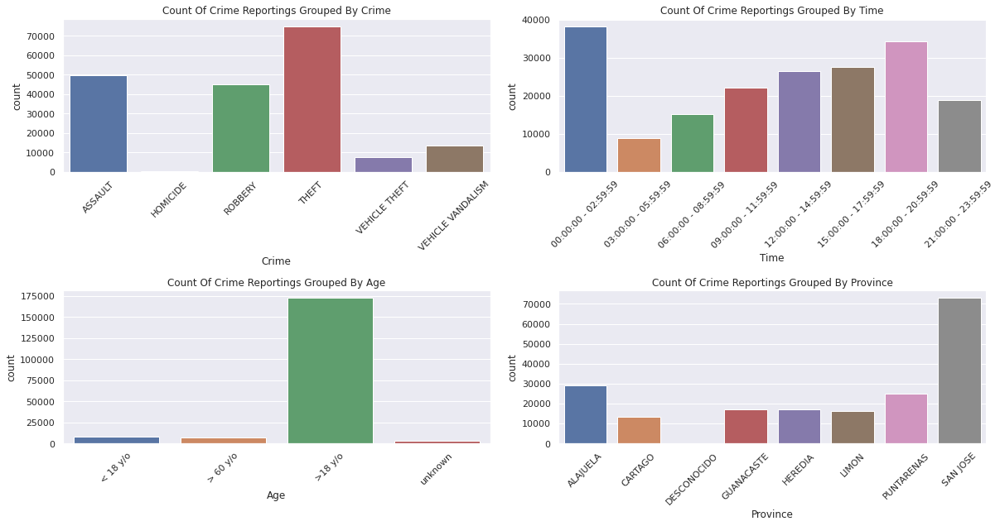

In [ ]:
#@title Categorical analysis

date_filter = df_crimes.index < '2020-3-1'
df_crimes_female = df_crimes[date_filter & female_filter]
categories = ['Crime', 'Time', 'Age', 'Province']
fig, axs = plt.subplots(ncols=2, nrows=2)
for idx, category in enumerate(categories):
    _plot = sns.countplot(data=df_crimes_female, x=category,
                  ax=axs[int(idx/2), idx % 2])
    _plot.set_xticklabels(_plot.get_xticklabels(), rotation=45)
    _plot.set(title=f'Count Of Crime Reportings Grouped By {category}')

fig.tight_layout()

The top left plot shows us what kind of crime is happening Costa Rica. This plot shows the most generic category this crime can be assigned to. The dataset provides a column that holds a more specific description. This variable allows us to compare the crime statistic of Costa Rica with other countries. When we compare it to Austria `[1]`, we can see that the violent disorder are way more prevalent in Costa Rica when compared to other countries. Because of the structure of the crime and the social and economic structure, we can not rely on research that was conducted in different countries. 

In the bottom right plot we can see again, that the majority of crimes is happening in the San Jose province. One big challenge is, that the crime records are only available on a district basis. This makes it challenging to infer anything about the circumstances about where this crime has happend. 

Costa Rica is pretty close to equator, that means that the sun is rising at 06:00 and is going down at 18:00. That splits the day perfectly in half throughout the year. That means that there is almost as much crime happening during the day with sunlight as there is crime happening when there is no sunlight. 

`[1]` https://bundeskriminalamt.at/501/files/2022/PPT_Kriminalitaetsentwicklung_GESAMT_26022022_bf.pdf

In [ ]:
#@title Crime per week analysis
tmp = df_crimes.copy()
tmp['weekday'] = tmp.index.weekday
fig = px.line(tmp[female_filter].groupby('weekday').count().reset_index(), x='weekday', y='Unnamed: 0', labels={'weekday':'Day of the week', 'Unnamed: 0':'Amount of crime'}, title='Trend of crime per week')
fig.update_layout(
    xaxis = dict(
        tickmode='array',
        tickvals=[0,1,2,3,4,5,6],
        ticktext = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
    )
)

Please be aware of the y-axis scale. We can see, that the crime is evenly spread accros the week, with a peak on friday and saturday and a bit of low on sunday. This is a intuitive observeration as we would expect criminals not to be on a regular weekly schedule.

#### Predicting crimes 

As mentioned in the previous discussion we will focus on the canton San Jose. In this section we are predicting the number of crimes that will happen in each district in the canton San Jose. We will use Prophet `[1]` to perform univariate timeseries prediciton and fit a model for each of the series. 

In the first section we discussed the COVID effects in the data. Because of that we omit all data starting from 2020 in order get good results. Please see the next plot for an explanation. 

`[1]` https://facebook.github.io/prophet/

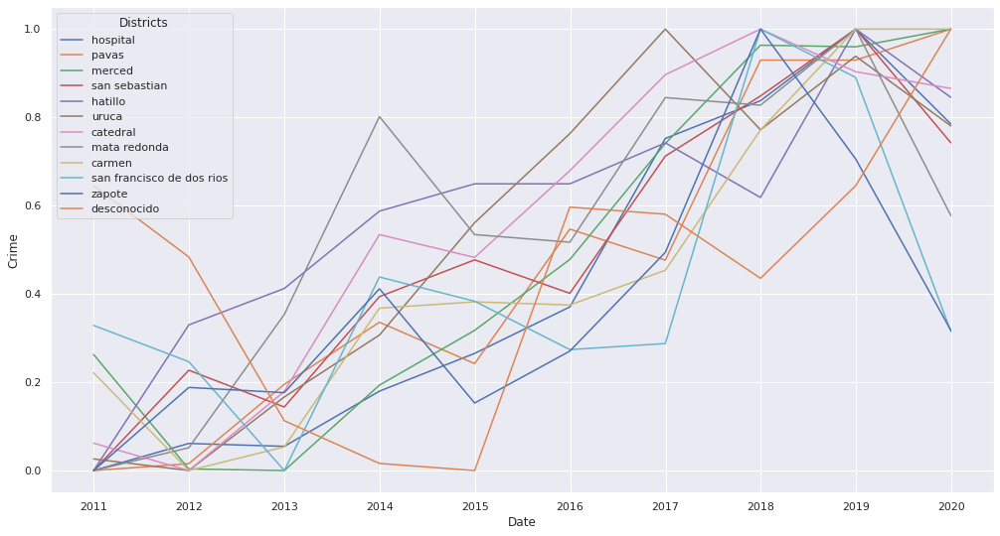

In [ ]:
#@title District relative analysis
female_filter = df_crimes['Gender'] == 'female'
province_filter = df_crimes['Canton'].str.lower() == 'san jose'
subtype_is_person = df_crimes['SubtypeVictim'].str.lower().str.contains('person')
df_crimes_filtered = df_crimes[female_filter & province_filter & subtype_is_person]

crime_sum = len(df_crimes_filtered)
fig , ax = plt.subplots()
for district in df_crimes_filtered['District'].unique():
  time_filter = df_crimes_filtered.index < '2020-01-01'
  district_filter = df_crimes_filtered['District'].str.lower() == district
  tmp = df_crimes_filtered[district_filter & time_filter]
  x = tmp.resample('1Y').count().reset_index()['Date']
  y = tmp.resample('1Y').count().reset_index()['Crime']
  y = (y - y.min()) / (y.max() - y.min())

  _ = sns.lineplot(x=x, y=y)

_ = plt.legend(title='Districts', loc='upper left', labels=df_crimes_filtered['District'].unique())

For this plot, the data was normalized between 0 and 1. It shows, that the underlying generator function (i.e. pattern) for each district is very similar and they follow the same over the last years. Computing and index means that we are not interested in absolute numbers, but in how the relate to each other. We can clearly observe, that the pattern continues after 2020. \
That is why we choose to only take into account the data until 2020 and predict from this point onwards. The data is aggreated in trisemester and we predict 14 trisemester or 3.5 years into the future. The final date for prediction is therefore in mid 2023 which means that we can predict one year or 4 trisemester into the future from the current date (March 2022).

In [ ]:
#@title Fig: Prediction model per disctric
def get_prediction_model(df, district=None):
  # df_prediction = df[(df['Category'] == load_type) & (df['Load Time'] < '2020-1-1')].resample('d').sum()
  df_prediction = df.copy()
  df_prediction = df_prediction.resample('3M').sum()
  df_prediction.reset_index(inplace=True)
  print(df_prediction.columns)
  df_prediction = df_prediction.rename(columns={
      'Date': 'ds',
      'Unnamed: 0': 'y'
  })

  model = Prophet()
  model.fit(df_prediction)

  return model

def get_predictions_for_model(model, days):
  future = model.make_future_dataframe(periods=days, freq='3M')
  predictions = model.predict(future)

  return predictions

forecast_period = 14 # trisemesters

date_filter = df_crimes.index < '2020-1-1'

predictions = dict()
for district in df_sanjose['District']:
  df_crimes_district_filter = (df_crimes['Canton'] == 'SAN JOSE') & (df_crimes['District'] == district)
  df_crimes_women = df_crimes[female_filter & date_filter & df_crimes_district_filter]
  model = get_prediction_model(df_crimes_women)
  pred = get_predictions_for_model(model, forecast_period)
  predictions[district] = pred


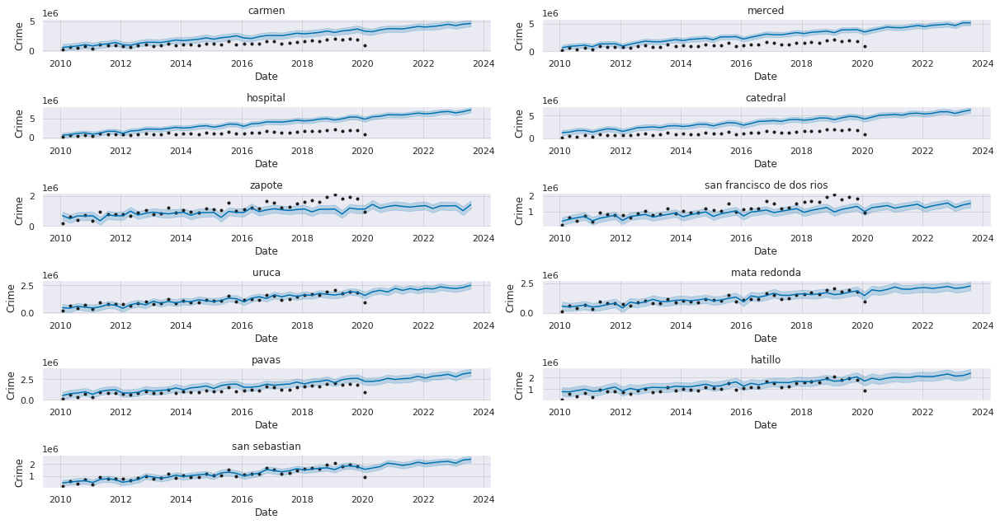

In [ ]:
#@title Prediction plots
fig, axs = plt.subplots(6, 2)
axs = axs.flatten()
for idx, district in enumerate(df_sanjose['District']):
  model.plot(predictions[district], ax=axs[idx], figsize=(12, 10),
             xlabel='Date', ylabel='Crime')
  axs[idx].set_title(district)
fig.delaxes(axs[-1])
fig.tight_layout()

Each prediction plot shows the underlying data as black dots and the prediction line is blue. The light blue band is the 90% confidence interval. Be aware that these plots lack scale and are therefore hard to interpret. But one can see, that we are spot on for most of the districts and a bit of for some of them. For brevity the cross-validation will be skipped as it is not the main challenge. The results will be verified in the computation of index into the future. 

#### 🔍 Results & Summary

This concludes the the first section of our report. 

1. Only data from the canton San Jose is used as it is the place with the highest populuation and crime rate. Additionally we have the most data available for this canton. 
1. Data from 2020 onwards is omitted to simplify prediction 
1. It is possible to remove the data after C because we are not intereseted in absolute numbers but rather in the relation between the districts 
1. A time series prediction model is fitted for each district



### 📈 Part 2: INDEX

#### Data used

The `district_data` dataset provides the most information. Interestingly, they also already provided us with an security category that was computed during the IDS 2017 `[1]`. To be statistically sound we will exclude this variable to not have a potential target variable in one of our descriptive variables. 
Besides that, the following variables were included, which were selected according to literature.

- Económica - Economic
- Educación - Education
- Densidad de población - Population density
- Relación hombres mujeres - Ratio men to women 2011 census
- Porcentaje de población no asegurada - Percentage of uninsured population

The number of crimes were aggregated by year and were joined to dataframe. As a normalization step we computed the number of crimes per 100 inhabitants. 

WDL provided provided a lot of datasets from arcGIS with various information about the districts in the canton San Jose. None of the datasets contain any information that can be directly used as a descriptive variable to compute a index. Furthermore, none of the datasets are desribed in literature to be important for computing an index. We want to invite researchers, that is why we built functions that allow to merge information from other dataframes. In our example we counted the number of *Entertainment and Culture* and number of *churches* for each district. Again, we normalized them per 100 inhabitants 

This gives us a final dataframe with the following variables: 

- Económica - Economic
- Educación - Education
- Densidad de población - Population density
- Relación hombres mujeres - Ratio men to women 2011 census
- Porcentaje de población no asegurada - Percentage of uninsured population
- Count entertainment (normalized)
- Count churches (normalized)
- Count crimes (normalized)

The careful reader might have already noticed that the only temporal variable in this dataset is the number of crimes. The implications of this will be discussed when computing the index for the future. 


`[1]` https://www.mideplan.go.cr/indice-desarrollo-social

,Crime_norm,Crime_norm
Económica,0.354509,0.354509
Educación,0.807330,0.807330
Densidad de población,-0.596709,-0.596709
Relación hombres mujeres,-0.639942,-0.639942
Porcentaje de población no asegurada,0.041827,0.041827
entertainment,0.934845,0.934845
churches,0.441593,0.441593
Crime_norm,1.000000,1.000000
Crime_norm,1.000000,1.000000


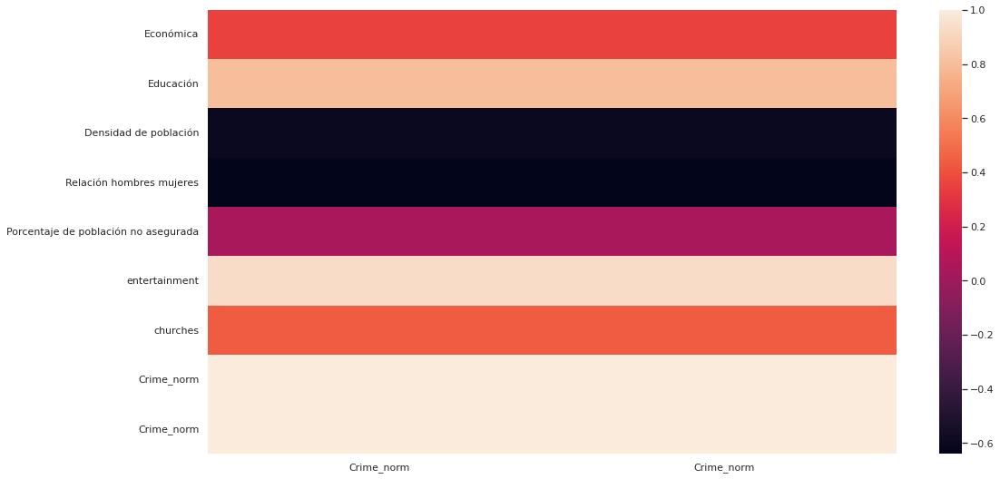

In [ ]:
#@title Corrleation
columns = [
    'Económica',
    'Educación',
    'Densidad de población',
    'Relación hombres mujeres',
    'Porcentaje de población no asegurada',
    'entertainment',
    'churches',
    'Crime_norm'
]
df_districts = pd.read_csv(os.path.join(
    'data/datasets/', 'district_data.csv'))

# Explode collection of {Province, Canton, District} into columns
df_districts['tmp'] = df_districts['{Provincia, Canton, Distrito}'].str.translate({ord('{'): '', ord('}'): '', ord('"'): ''}).str.split(',')
tmp = df_districts['tmp'].apply(pd.Series).rename({0: 'Province', 1: 'Canton', 2: 'District'}, axis=1)
df_districts = df_districts.join(tmp).drop(columns=['tmp', '{Provincia, Canton, Distrito}']).astype({
    'District': str,
})

for column in ['Province', 'Canton', 'District']:
  df_districts[column] = pd.Series(df_districts[column], dtype="string")
  df_districts[column] = df_districts[column].str.strip().str.lower()

df_corr = df_sanjose.copy()#[columns + ['Crime', 'Población total']]
df_corr['Crime_norm'] = (df_corr['Crime'] / df_corr['Población total']) * 10_000
for column in ['churches', 'entertainment']:
  df_corr[column] = (df_corr[column] / df_corr['Población total']) * 10_000

corr_columns = columns + ['Crime_norm']

corr = df_corr[corr_columns].corr()
sns.heatmap(corr[['Crime_norm']], 
            xticklabels=corr[['Crime_norm']].columns.values,
            yticklabels=corr.columns.values)
corr_values = corr[['Crime_norm']]# .values[:-1]
corr_values

The correlation plot agrees with the literature. 

#### Computing the index

Computing an composite index of any kinde involves specialists that know the implications variable in the system. With this knowledge about the system they are able to estimate the impact of each variable in the form of a weight that can then be used to compute a weighted sum. 

We want to make clear, that we are not specialised in either:
- The causes and implications of crime 
- Crime against women
- Circumstances of people living in Costa Rica

For that reason we will not subject us to building a representable security index for Costa Rica. That is the reason why we decided to build a framework and rely on statistics and literature to build a score. We consulted the OECD handbook for constructing composite indicators. `[1]` 
From that, we selected to use Factor Analysis to build our index based on the variables mentioned above. 

Steps we take to compute the score:
1. Normalize number of churches, entertainment and crime against 100 inhabitants
1. Compute a factor analysis of the dataframe
1. Rotate the factor analysis to create the varimax matrix
1. Extract the max values from each row

`[1]` https://www.oecd.org/sdd/42495745.pdf  

In [ ]:
#@title Computing the index
def get_index(data, crime_values):
  """
  crime_values have to be in shape (11,)
  One prediction 
  """
  data = data.copy()
  data['Crime_norm'] = 0
  for column in columns:
    data[column] = data[column].astype(np.float64)
  df_corr = data.copy()#[columns + ['Crime', 'Población total']]
  for column in ['churches', 'entertainment']:
    df_corr[column] = (df_corr[column] / df_corr['Población total']) * 100

  
  df_corr['Crime_norm'] = crime_values / df_sanjose['Población total'].values * 100
  # Refer to page 89
  t = FactorAnalysis(rotation="varimax")
  tt = t.fit_transform(df_corr[columns].T)
  weights = np.amax(tt, axis=-1)
  score = np.sum((df_corr[columns].values * weights), axis=-1)
  score = np.array([(score - np.min(score)) / (np.max(score) - np.min(score))]).T * 100
  return score, weights

scores, weights = get_index(df_sanjose, df_sanjose['Crime'].values)
pp.pprint(dict(zip(columns, weights)))

weights_df = pd.DataFrame([columns, weights]).T
fig = px.line_polar(weights_df, r=1, theta=0, line_close=True)
weights_df
fig

{   'Crime_norm': 2.193784670268946,
    'Densidad de población': 2.6456811753593414,
    'Económica': 1.7747477350752656,
    'Educación': 2.309777856306638,
    'Porcentaje de población no asegurada': 1.5321545860442276,
    'Relación hombres mujeres': 0.13148845908428067,
    'churches': 0.824947476476467,
    'entertainment': 0.8302669764243291}


Factor Analysis is a method that takes all variables and transform them into a different representation. This solves the problem of collinearity and also describes the impact that each variable has on the complete dataset. 

The radar chart shows the main driving factors are: 
- Number of crime (Normalized)
- Economy
- Education
- Population density 

It also shows that the number of churches and entertainment has indeed some impact into explaining the data. 

In [ ]:
#@title Plot index
scores[0].flatten()
df_sanjose_evaluate = df_sanjose.copy()
df_sanjose_evaluate['Our Index'] = scores
df_sanjose_evaluate['Crime_norm'] = df_sanjose_evaluate['Crime'] / df_sanjose_evaluate['Población total'].values * 10_000
df_sanjose_evaluate[['District', 'Our Index', 'Seguridad']].sort_values(by='Seguridad')

,District,Our Index,Seguridad
0,carmen,0.000000,36.94
2,hospital,38.010185,70.54
1,merced,34.586465,76.23
3,catedral,37.198041,84.17
6,uruca,18.468679,85.07
7,mata redonda,3.307089,85.89
10,san sebastian,82.194799,87.39
9,hatillo,100.000000,90.06
8,pavas,57.519530,90.07
4,zapote,46.619376,91.90


We assume that the *Seguridad* score from the **IDS 2017** data release is a actual representative security score for each district. Comparing our score against the *Seguridad* score clearly shows that we do not match it for most of the districts.
One important aspect is, that we scale the index from 0-100, with such little observations (i.e. districts) this leaves huge gaps because there might be districts outside of the San Jose canton that are unsafe according to our index. 



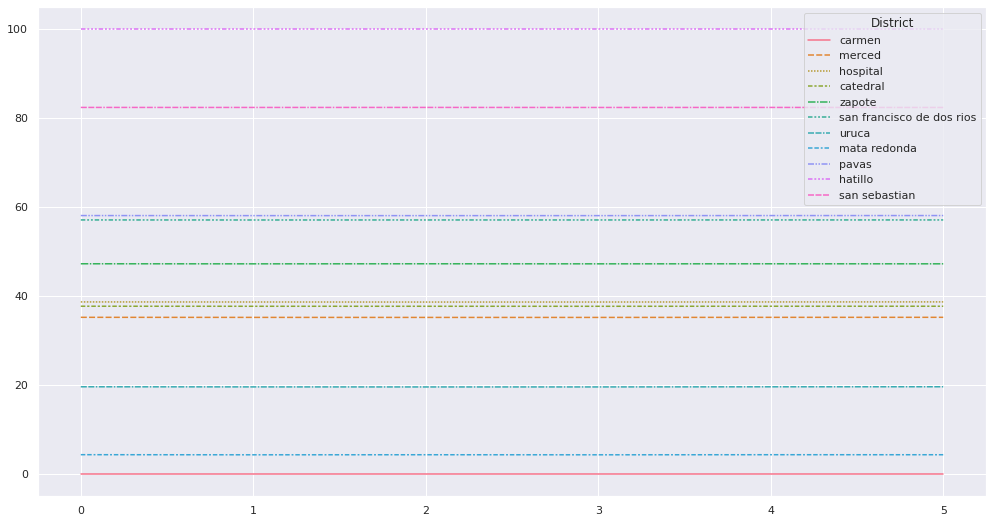

In [ ]:
#@title Future index
preds_for_index = list()

for district in df_sanjose['District']:
  tmp = predictions[district].copy()
  date_filter = (tmp['ds'] >= '2022-04-01')# & (tmp['ds'] <= '2023-06-01')
  preds_for_index.append(tmp[date_filter]['yhat'].values / 10_000)


preds_for_index = np.array(preds_for_index)
df_preds_for_index = pd.DataFrame(preds_for_index.T, columns=df_sanjose['District'].values)

predicted_indices = list()
for idx, row in df_preds_for_index.iterrows():
  scores, weights = get_index(df_sanjose, row.values)
  predicted_indices.append(scores)

predicted_indices = np.array(predicted_indices)
df_predicted_indices = pd.DataFrame(predicted_indices.T[0].T, columns=df_sanjose['District'])
_ = sns.lineplot(data=df_predicted_indices)

In [ ]:
df_predicted_indices

District,carmen,merced,hospital,catedral,zapote,san francisco de dos rios,uruca,mata redonda,pavas,hatillo,san sebastian
0,0.0,35.242939,38.703473,37.738089,47.281380,57.137823,19.625234,4.356311,58.121222,100.0,82.434338
1,0.0,35.227517,38.688134,37.726579,47.266254,57.125360,19.597138,4.330450,58.106845,100.0,82.429139
2,0.0,35.220073,38.675823,37.727345,47.279659,57.131722,19.585486,4.343696,58.104518,100.0,82.435758
3,0.0,35.219455,38.682630,37.722072,47.267552,57.131800,19.588394,4.329803,58.106241,100.0,82.425046
4,0.0,35.239012,38.699561,37.734837,47.277921,57.136518,19.618660,4.350673,58.118590,100.0,82.432721
5,0.0,35.243783,38.711330,37.734492,47.270080,57.137562,19.629864,4.343935,58.123363,100.0,82.425063


This table shows what was mentioned multiple times above. Because the only temporal variable is the number of crimes and distribution of number of crimes between the districts stays relatively constant, the index will not change much over time. 
That is why the prediction of the index does not add any value. 

#### 🔍 Results & Summary

In this section we did show how we tackled the problem of computing a security indicator for the canton of San Jose. Our work acts as a base framework for gathering and merging data and by providing a statistically sound method to compute an indicator. But we found out that the data provided was not sufficient to compute a meaningful indicator. For that reason we would like to invite Costa Rica officials to provide more data and social scientists help us to explain factors in Costa Rica. 

1. We used factor analysis together with the method described in the *Handbook on Constructing Composite Indicators* to compute a composite index
1. Create radar charts that allow researchers to better understand which variables contribute towards explaining the dataset 
1. Compared the index with the provided security score from WDL
1. Predicted the security score into the future



### ✊ Part 3: GOOGLE REVIEWS


Users are able to post a review and express their feelings about every location that is available on Google Maps. The challenge providers offered us a dataset that contains Google reviews about every transit and park locations all over Costa Rica. 
The dataset contains: 
- Review rating on a scale between 1 and 5
- Review text that the user provided 
- Exact coordinates of the reviewed location

Given that data we built a system that extracts information from the review text whether a place is unsafe or safe. We then visualise the reviews parks and transit stations on a map allowing the user to visually inspect the locations. 

Google Reviews are separated into two distinct categories: *Park Reviews* and *Transit Reviews*.

*Transit Reviews* data was obtained by querying bus stop locations in San Jose using Open Street Map. Afterwards, transit station were located in a 5km radius of each of the bus stops using Google Places API. Thus, the data contains information about most of the transit stations in San Jose.

For *Park Reviews*, parks located in Costa Rica were queried using OpenStreetMap (OSM). As previously mentioned, Google Places API was then used to crawl the reviews.

Review files in JSON format are firstly normalized and preprocessed.

Review text data is unannotated, as is the case in many real-world settings, thus zero-shot classifier is used to evaluate a sentiment of a sentence, and to flag it for further analysis if necessary.
As per our research, we have opted for the following labels:

**safe, secure, happy, family** - indicate a review that should not be flagged

**assault, crime, rape, dangerous** indicate a review that should be flagged

Facebooks `bart-large` is chosen as the model, the model was pretrained on the MultiNLI (MNLI) dataset.

In [ ]:
!wget https://wdl-data.fra1.digitaloceanspaces.com/urbanalytica/google_reviews.zip
!unzip -o google_reviews.zip
!gdown 1asobaV3zlLXXa3zgKu38TtmbUd450C0j
!gdown 1uRGuBeDxmJHvo_rK69uKBy1D3EnJa7hT

In [ ]:
classifier = pipeline("zero-shot-classification",
                      model="facebook/bart-large-mnli")

In [ ]:
#@title Classfiy reviews
def create_point(x):
  return Point(x[0], x[1])

def flag_text(x):
  if x=="":
    return ""
  result = classifier(x, candidate_labels)
  score = np.argmax(result['scores'])
  return candidate_labels[score]

def check_safe(x):
  try:
    index = candidate_labels.index(x)
  except ValueError:
    return 0
  if index>3:
    return 1
  return 0

def load_google_reviews(dataset="parks",pickled=False):
  if pickled:
    with open(f'df_g{dataset}.pkl', 'rb') as fid:
      df = pickle.load(fid)
  else:
    with open(f"google_reviews_{dataset}.json") as data:
      json_data = json.load(data)
    if dataset=="parks":
      dataset="park"
    for x in json_data[f'{dataset}_reviews']:
      if not 'reviews' in x['result']:
        x['result']['reviews'] = []
    df = pd.json_normalize(json_data[f'{dataset}_reviews'], record_path=['result','reviews'], meta=[['result','geometry','location','lat'], ['result','geometry','location','lng'], ['result','name']])

    df['geometry'] = df[['result.geometry.location.lng', 'result.geometry.location.lat']].agg(create_point, axis=1)

    df['flag'] = df['text'].apply(flag_text)
    df['unsafe'] = df['flag'].apply(check_safe)

  cols=['text','time','result.name','geometry','flag','unsafe']
  
  return df[cols]

non_flag_labels = ['safe', 'secure','happy','family']
flag_labels=['assault','crime','rape','dangerous']
candidate_labels = [*non_flag_labels, *flag_labels]

df_gparks = load_google_reviews(dataset="parks",pickled=True)
df_gtransit = load_google_reviews(dataset="transit",pickled=True)

A preview of the data is shown below.

In [ ]:
df_gtransit.head()

,text,time,result.name,geometry,flag,unsafe
0,,1449007711,Parada Lomas,POINT (-84.16226329999999 9.959165900000002),,0
1,,1584296821,Parada Lomas,POINT (-84.16226329999999 9.959165900000002),,0
2,No whether protection,1558370211,Parada Estadio Nacional,POINT (-84.1092607 9.936771400000001),secure,0
3,You have to be careful at night,1490236532,Parada Estadio Nacional,POINT (-84.1092607 9.936771400000001),dangerous,1
4,,1503009940,Parada Estadio Nacional,POINT (-84.1092607 9.936771400000001),,0


Reviews flagged by the model are displayed on the map which allows for further geospatial analysis.

In [ ]:
#@title Visualise classified reviews
map = folium.Map(location=[9.93,-84.07], zoom_start=15,
                 tiles='https://api.mapbox.com/styles/v1/mapbox/dark-v10/tiles/{z}/{x}/{y}?access_token=pk.eyJ1IjoibHVtb2UiLCJhIjoiY2wyNXk1a3FnMG4wNDNjcWl5OGhkOXR5dCJ9.Q56CyIVs0C-kaED1Q4HJtQ',
                 attr='Mapbox')
df_gtransit_flag = df_gtransit[df_gtransit.unsafe==1]
for indice, row in df_gtransit_flag.iterrows():
    folium.Marker(
        location=[row['geometry'].y,row['geometry'].x],
        popup=f"""<h3>{row['result.name']}</h3> <br> <h4>{row['flag']}</h4> <br> Review text: {row['text']}""",
        icon=folium.Icon(color="darkpurple", icon='exclamation', prefix='fa')
        ).add_to(map)
df_gparks_flag = df_gparks[df_gparks.unsafe==1]
for indice, row in df_gparks_flag.iterrows():
    folium.Marker(
        location=[row['geometry'].y,row['geometry'].x],
        popup=f"""<h3>{row['result.name']}</h3> <br> <h4>{row['flag']}</h4> <br> Review text: {row['text']}""",
        icon=folium.Icon(color="darkblue", icon='exclamation', prefix='fa')
        ).add_to(map)
map

#### 🔍 Results & Summary
In Part 3 we show that it is possible to use a pre trained neural network architecture to flag dangerous parks and transit stations. The system still requires fine tuning and filtering in order to remove false positives. 

The big advantage of this system is that it can be used in near realtime and additional data sources can be easily added to the system. 

## 👓 References
Data:

- https://wdl-data.fra1.digitaloceanspaces.com/urbanalytica/urbanalytica_datasets.zip
- https://wdl-data.fra1.digitaloceanspaces.com/urbanalytica/google_reviews.zip

Articles and Papers:

- http://esri.github.io/geometry-api-java/doc/Polygon.html
- https://en.wikipedia.org/wiki/Provinces_of_Costa_Rica 
- https://en.wikipedia.org/wiki/Cantons_of_Costa_Rica   
- https://en.wikipedia.org/wiki/Districts_of_Costa_Rica 
- https://bundeskriminalamt.at/501/files/2022/-PPT_Kriminalitaetsentwicklung_GESAMT_26022022_bf.pdf
- https://facebook.github.io/prophet/
- https://www.mideplan.go.cr/indice-desarrollo-social
- https://www.oecd.org/sdd/42495745.pdf  

- https://www.sciencedirect.com/science/article/pii/S0198971516304240
- https://link.springer.com/article/10.1007/s10940-020-09490-6
- https://studiogang.com/project/neighborhood-activation-study
- https://crimesciencejournal.biomedcentral.com/articles/10.1186/s40163-020-00125-6
- https://link.springer.com/article/10.1007/s10940-016-9306-9
- https://infosegura.org/en/2021/06/18/violence-against-women-costa-rica-2020/
- https://whe.org.au/creating-safe-and-inclusive-public-spaces-for-women/ 

## ⏭️ Appendix